In [1]:
import os
import sys
import pickle

import sys
import commonutils
from commonutils import ModelResults

import numpy as np

import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error
#from sklearn.metrics import root_mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.inspection import permutation_importance
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

from dataclasses import dataclass

from sklearn.cross_decomposition import PLSRegression
import warnings

from sklearn import preprocessing

from copy import deepcopy
import pickle

import numpy as np
from sklearn.model_selection import LeaveOneOut
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.inspection import permutation_importance
from sklearn.preprocessing import StandardScaler
from sklearn.utils.estimator_checks import check_estimator

from sklearn.linear_model import LinearRegression

from commonutils import ModelsStore
warnings.simplefilter("ignore")

from commonfuncsforcli import *

sys.path.append('./CLossLr')
import customlosslr as clr



In [2]:
rootdir = './Results'
selected_basisset = "QZVP"
selected_functional = "PBE0" 
REMOVEFLPSFROMTRAINING = False

models = {}
for dir in os.listdir(rootdir):
    if os.path.isdir(os.path.join(rootdir, dir)):
        if dir == selected_functional+"_"+selected_basisset:
            for file in os.listdir(os.path.join(rootdir, dir)):
                if file.endswith('.pkl'):
                    print(f'Loading model from {os.path.join(rootdir, dir, file)}')
                    with open(os.path.join(rootdir, dir, file), 'rb') as f:
                        model = pickle.load(f)
                        modelname = file.replace('.pkl', '')
                        print(f'  Loaded model {modelname}')
                        models[modelname] = model
   


Loading model from ./Results/PBE0_QZVP/SMALL_MOLECULES_custom_lr_model_splitted.pkl
  Loaded model SMALL_MOLECULES_custom_lr_model_splitted
Loading model from ./Results/PBE0_QZVP/Full_custom_lr_model.pkl
  Loaded model Full_custom_lr_model
Loading model from ./Results/PBE0_QZVP/rfmodel.pkl
  Loaded model rfmodel
Loading model from ./Results/PBE0_QZVP/INTERMOLECULAR_INTERACTIONS_custom_lr_model_splitted.pkl
  Loaded model INTERMOLECULAR_INTERACTIONS_custom_lr_model_splitted
Loading model from ./Results/PBE0_QZVP/LARGE_SYSTEMS_custom_lr_model.pkl
  Loaded model LARGE_SYSTEMS_custom_lr_model
Loading model from ./Results/PBE0_QZVP/BARRIER_HEIGHTS_custom_lr_model_splitted.pkl
  Loaded model BARRIER_HEIGHTS_custom_lr_model_splitted
Loading model from ./Results/PBE0_QZVP/INTERMOLECULAR_INTERACTIONS_custom_lr_model.pkl
  Loaded model INTERMOLECULAR_INTERACTIONS_custom_lr_model
Loading model from ./Results/PBE0_QZVP/INTRAMOLECULAR_INTERACTIONS_custom_lr_model.pkl
  Loaded model INTRAMOLECULAR_I

In [3]:
equations = {"Te": "Kinetic_Energy", \
         "V_NN": "Nuclear_Repulsion",\
         "V_eN": "One_Electron_Energy - Kinetic_Energy",\
         "EX": "EX",\
         "E_J": "Two_Electron_Energy - EX - EC",\
         "DC": "Dispersion_correction",\
         "EC": "EC"}
SHIFTFT = "DC"

IMPORTMODELTOSTART = False

functionals = []
basis_sets = []

print("Selected functional: ", selected_functional)
print(" Selected basis set: ", selected_basisset)
print("        Functionals: ", functionals)
print("         Basis sets: ", basis_sets)

featuresvalues_perset,\
fullsetnames, \
models_results, \
supersetnames = readdata(shiftusingFT=SHIFTFT, \
                selected_functionalin=selected_functional, \
                selected_basisin=selected_basisset, \
                equations=equations)

sep = "_"
for setname in fullsetnames:
    desciptors = {}
    k = selected_functional + sep +\
                selected_basisset 
    for features in featuresvalues_perset[setname]:
        for val in features:
            if val.find(k) != -1:
                if val not in desciptors:
                    desciptors[val] = [features[val]]
                else:
                    desciptors[val].append(features[val])

    for features in featuresvalues_perset[setname]:
        for val in features:
            for func in functionals:
                for basis in basis_sets:
                    if not(basis == selected_basisset and \
                            func == selected_functional):
                        if val.find(func + sep + basis) != -1:
                            actualk = val 
                            refk  = selected_functional + sep  + \
                                    selected_basisset + \
                                    val.replace(func + sep + basis, "")
                            newk = actualk + "_difftoref"
                            if newk not in desciptors:
                                desciptors[newk] = [features[actualk]-features[refk]]
                            else:
                                desciptors[newk].append(features[actualk]-features[refk])
    
    models_results[setname].features = desciptors

# features selection
setname = "Full"
numoffeat = len(models_results[setname].features)
print("Number of features for ", numoffeat)
for setname in fullsetnames:
    if len(models_results[setname].features) != numoffeat:
        print("Number of features for ", setname, " is different")
        sys.exit(1)

toremove = []
setname = "Full"
for k in models_results[setname].features:
    if len(set(models_results[setname].features[k])) == 1:
        toremove.append(k)
        print("Constant fatures to remove: ", k)

# remove constant values
for setname in fullsetnames:
    for k in toremove:
        del models_results[setname].features[k]

# force removing features Nuclear Repulsion difference
tormfeatname = set()
print("Removing Nuclear Repulsion differences")
for setname in fullsetnames: 
    toremove = []
    for k in models_results[setname].features:
        if k.find("NR_difftoref") != -1:
            toremove.append(k)
    for k in toremove:
        #print("Removing feature ", k)
        tormfeatname.add(k)
        del models_results[setname].features[k]

print("Removed features: ", tormfeatname)
setname = "Full"
numoffeat = len(models_results[setname].features)
print("Number of features ", numoffeat)
for setname in fullsetnames:
    if len(models_results[setname].features) != numoffeat:
        print("Number of features for ", setname, " is different")
        sys.exit(1)

Selected functional:  PBE0
 Selected basis set:  QZVP
        Functionals:  []
         Basis sets:  []
Shifting using  DC
Printing also to stdout:  False
Setname:  BARRIER_HEIGHTS
DC Error  PBE MINIX  compare to  PBE0 MINIX -4.12700e-01 -3.36461e-01  systems  h n2o n2ohts  h n2o n2ohts 
Setname:  BARRIER_HEIGHTS
DC Error  PBE MINIX  compare to  PBE0 MINIX -6.95756e-01 -5.71754e-01  systems  oh n2 n2ohts  oh n2 n2ohts 
Setname:  BARRIER_HEIGHTS
DC Error  PBE MINIX  compare to  PBE0 MINIX -1.23422e-01 -9.55032e-02  systems  h hf hfhts  h hf hfhts 
Setname:  BARRIER_HEIGHTS
DC Error  PBE MINIX  compare to  PBE0 MINIX -1.23422e-01 -9.55032e-02  systems  hf h hfhts  hf h hfhts 
Setname:  BARRIER_HEIGHTS
DC Error  PBE MINIX  compare to  PBE0 MINIX -2.36415e-01 -1.94667e-01  systems  h hcl hclhts  h hcl hclhts 
Setname:  BARRIER_HEIGHTS
DC Error  PBE MINIX  compare to  PBE0 MINIX -2.36415e-01 -1.94667e-01  systems  hcl h hclhts  hcl h hclhts 
Setname:  BARRIER_HEIGHTS
DC Error  PBE MINIX  co

In [4]:
for setname in ["Full"] + list(supersetnames): 
    print(f'Processing dataset {setname}')
    X, y, features_names = \
            commonutils.build_XY_matrix \
            (models_results[setname].features, \
            models_results[setname].labels)

    # print average values and standard deviation for each feature in X sorted by absolute value
    print("Feature values (mean ± std):")
    for i in range(X.shape[1]):
        print(f"  {features_names[i]:20s}: {X[:, i].mean():.3e} "
              f"(std: {X[:, i].std():.3e})")

    X_train, X_test, y_train, y_test \
          = train_test_split(X, y, test_size=0.15, random_state=42)
    
    for k in models:
        if k.find(setname) != -1:
            print("  Loading model:", k)
            model = models[k]

            #check_estimator( model)
            #scaler = StandardScaler()
            #X_scaled = scaler.fit_transform(X)
            #model.fit(X_scaled, y)

            #y_pred = model.predict(X_test)
            #rmse = mean_squared_error(y_test, y_pred, squared=False)
            #print(f'  RMSE for dataset {setname}: {rmse}')
            # run a permutation features importance analysis using permutation_importance
            scoring_metrics = ['r2', 'neg_mean_squared_error', 'neg_mean_absolute_error']
            scoring_metrics = ['r2'] # use only r2 to partially avoid problems related to the non scaled values 
            all_importances_mean = []
            all_importances_std = []
            for metric in scoring_metrics:
                result = permutation_importance(model, X, y,
                                    n_repeats=30,
                                    random_state=42,
                                    scoring=metric)
                all_importances_mean.append(result.importances_mean)
                all_importances_std.append(result.importances_std)
           
            avg_importance = np.mean(all_importances_mean, axis=0)
            avg_std = np.mean(all_importances_std, axis=0)

            sorted_idx = avg_importance.argsort()[::-1]

            #print(f"  Average Permutation Feature Importance across: {', '.join(scoring_metrics)}")
            print("    Full set")
            for i in sorted_idx:
                print(f"    {features_names[i]:20s}: {avg_importance[i]:.3e} "
                    f"(avg std: {avg_std[i]:.3e})")


Processing dataset Full
Feature values (mean ± std):
  PBE0_QZVP_Te        : -4.674e+01 (std: 1.299e+02)
  PBE0_QZVP_V_NN      : -3.008e+04 (std: 2.121e+05)
  PBE0_QZVP_V_eN      : 6.029e+04 (std: 4.244e+05)
  PBE0_QZVP_EX        : 2.614e+01 (std: 7.612e+01)
  PBE0_QZVP_E_J       : -3.015e+04 (std: 2.123e+05)
  PBE0_QZVP_EC        : 1.184e+01 (std: 3.443e+01)
  Loading model: Full_custom_lr_model
    Full set
    PBE0_QZVP_V_eN      : 1.612e+07 (avg std: 3.338e+05)
    PBE0_QZVP_E_J       : 4.032e+06 (avg std: 8.352e+04)
    PBE0_QZVP_V_NN      : 4.025e+06 (avg std: 8.333e+04)
    PBE0_QZVP_Te        : 1.471e+00 (avg std: 3.866e-02)
    PBE0_QZVP_EX        : 5.359e-01 (avg std: 1.424e-02)
    PBE0_QZVP_EC        : 8.630e-02 (avg std: 2.322e-03)
  Loading model: Full_custom_lr_model_splitted
    Full set
    PBE0_QZVP_V_eN      : 1.612e+07 (avg std: 3.338e+05)
    PBE0_QZVP_E_J       : 4.032e+06 (avg std: 8.352e+04)
    PBE0_QZVP_V_NN      : 4.025e+06 (avg std: 8.334e+04)
    PBE0_QZVP_

  Train set Average Permutation Feature Importance across: accuracy, f1_weighted, precision_weighted, recall_weighted
    PBE0_QZVP_EX        : 2.786e-01 (avg std: 9.497e-03)
    PBE0_QZVP_EC        : 2.456e-01 (avg std: 9.700e-03)
    PBE0_QZVP_Te        : 1.982e-01 (avg std: 8.282e-03)
    PBE0_QZVP_E_J       : 5.618e-02 (avg std: 4.484e-03)
    PBE0_QZVP_V_eN      : 5.066e-02 (avg std: 4.153e-03)
    PBE0_QZVP_V_NN      : 4.845e-02 (avg std: 4.291e-03)


  Test set Average Permutation Feature Importance across: accuracy, f1_weighted, precision_weighted, recall_weighted
    PBE0_QZVP_EX        : 2.149e-01 (avg std: 1.676e-02)
    PBE0_QZVP_EC        : 2.121e-01 (avg std: 2.020e-02)
    PBE0_QZVP_Te        : 1.361e-01 (avg std: 1.606e-02)
    PBE0_QZVP_V_NN      : 3.610e-02 (avg std: 1.052e-02)
    PBE0_QZVP_E_J       : 2.953e-02 (avg std: 1.139e-02)
    PBE0_QZVP_V_eN      : 2.544e-02 (avg std: 1.020e-02)


  Feature importance (extracted from the model):
    PBE0_QZVP_EX        : 2.

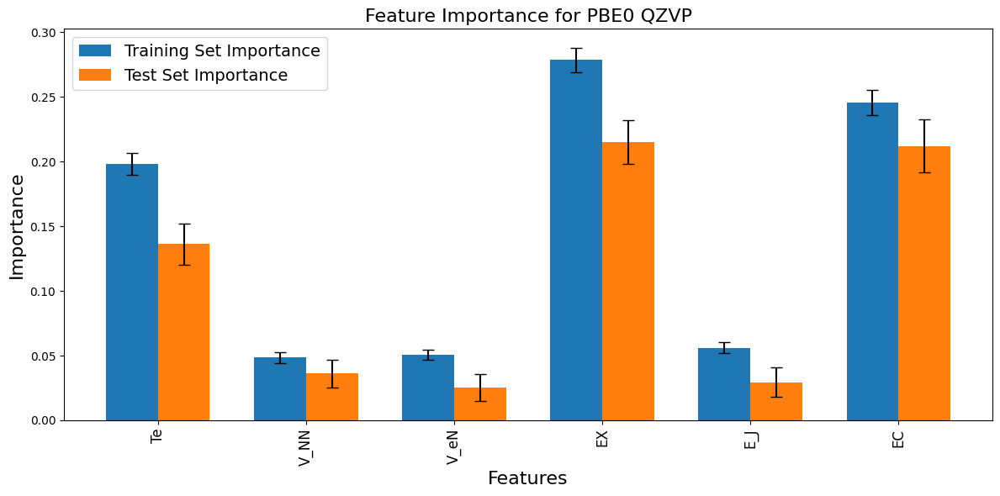

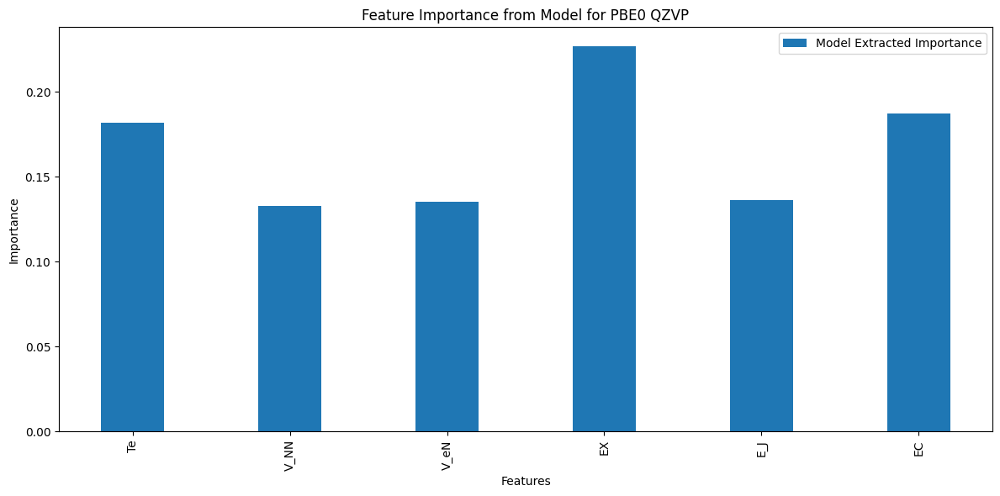

In [5]:
classes = []
features = {}
supersetnameslist = list(supersetnames.keys())
for setname in featuresvalues_perset:
    if setname in supersetnameslist:
        #print("Setname: ", setname)
        for entry in featuresvalues_perset[setname]:
            classes.append(supersetnameslist.index(setname))

X, _, features_names =\
        commonutils.build_XY_matrix (\
        models_results['Full'].features,\
        models_results['Full'].labels)
X_train, X_test, y_train, y_test = train_test_split(\
        X, classes, test_size=0.20, random_state=41)

rfmodel = models["rfmodel"]
scoring_metrics = ['accuracy', 'f1_weighted', 'precision_weighted', 'recall_weighted']

"""
all_importances_mean = []
all_importances_std = []
for metric in scoring_metrics:
    result = permutation_importance(rfmodel, X, classes,
                                    n_repeats=30,
                                    random_state=42,
                                    scoring=metric)
    all_importances_mean.append(result.importances_mean)
    all_importances_std.append(result.importances_std)
avg_importance = np.mean(all_importances_mean, axis=0)
avg_std = np.mean(all_importances_std, axis=0)
print(f"  Full set Average Permutation Feature Importance across: {', '.join(scoring_metrics)}")
sorted_idx = avg_importance.argsort()[::-1]
for i in sorted_idx:
    print(f"    {features_names[i]:20s}: {avg_importance[i]:.3e} "
          f"(avg std: {avg_std[i]:.3e})")

print("\n" + "="*60 + "\n")
"""

all_importances_mean = []
all_importances_std = []
for metric in scoring_metrics:
    result = permutation_importance(rfmodel, X_train, y_train,
                                    n_repeats=30,
                                    random_state=42,
                                    scoring=metric)
    all_importances_mean.append(result.importances_mean)
    all_importances_std.append(result.importances_std)
train_avg_importance = np.mean(all_importances_mean, axis=0)
train_avg_std = np.mean(all_importances_std, axis=0)
print(f"  Train set Average Permutation Feature Importance across: {', '.join(scoring_metrics)}")
sorted_idx = train_avg_importance.argsort()[::-1]
for i in sorted_idx:
    print(f"    {features_names[i]:20s}: {train_avg_importance[i]:.3e} "
          f"(avg std: {train_avg_std[i]:.3e})")

print("\n" + "="*60 + "\n")

all_importances_mean = []
all_importances_std = []
for metric in scoring_metrics:
    result = permutation_importance(rfmodel, X_test, y_test,
                                    n_repeats=30,
                                    random_state=42,
                                    scoring=metric)
    all_importances_mean.append(result.importances_mean)
    all_importances_std.append(result.importances_std)
test_avg_importance = np.mean(all_importances_mean, axis=0)
test_avg_std = np.mean(all_importances_std, axis=0)
print(f"  Test set Average Permutation Feature Importance across: {', '.join(scoring_metrics)}")
sorted_idx = test_avg_importance.argsort()[::-1]
for i in sorted_idx:
    print(f"    {features_names[i]:20s}: {test_avg_importance[i]:.3e} "
          f"(avg std: {test_avg_std[i]:.3e})")

print("\n" + "="*60 + "\n")

# The second part of the script remains the same for comparison
importances = rfmodel.feature_importances_
print("  Feature importance (extracted from the model):")
for i in importances.argsort()[::-1]:
    print(f"    {features_names[i]:20s}: {importances[i]:.3e}")

# plot an histogram using also standard deviation for train_avg_importance and test_avg_importance
import matplotlib.pyplot as plt

new_features_names = []
for f in features_names:
    newf = f.replace(selected_functional+"_"+selected_basisset+"_", "")
    new_features_names.append(newf)

plt.figure(figsize=(12, 6))
bar_width = 0.35
x = np.arange(len(new_features_names))

# Plotting train importances
plt.bar(x - bar_width/2, train_avg_importance, bar_width, yerr=train_avg_std, label='Training Set Importance', capsize=5)

# Plotting test importances
plt.bar(x + bar_width/2, test_avg_importance, bar_width, yerr=test_avg_std, label='Test Set Importance', capsize=5)
# increase font size of labels and titles
plt.xlabel('Features', fontsize=16)
plt.ylabel('Importance', fontsize=16)
plt.title('Feature Importance for ' + selected_functional + ' ' + selected_basisset, fontsize=16)
plt.xticks(x, new_features_names, rotation=90, fontsize=12)
plt.legend(fontsize=14)
plt.tight_layout()
#plt.show()
plt.savefig('feature_importance_'+selected_functional+'_'+selected_basisset+'.png', dpi=300)

# plot also the importances extracted from the model
plt.figure(figsize=(12, 6))
plt.bar(x, importances, width=0.4, label='Model Extracted Importance')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importance from Model for ' + selected_functional + ' ' + selected_basisset)
plt.xticks(x, new_features_names, rotation=90)
plt.legend()
plt.tight_layout()
#plt.show()
plt.savefig('feature_importance_model_'+selected_functional+'_'+selected_basisset+'.png',
            dpi=300)
